In [2]:
import joblib
import numpy as np
import pandas as pd
import missingno as msno
import seaborn as sns
import warnings
import nltk
import gensim
import cufflinks as cf
import plotly.graph_objs as go
import warnings

from matplotlib import pyplot as plt
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
from gensim import corpora
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from yellowbrick.cluster import KElbowVisualizer

%matplotlib inline
init_notebook_mode(connected = True)
warnings.filterwarnings("ignore",category=plt.cbook.mplDeprecation)

In [3]:
import plotly.io as pio
pio.renderers.default = 'jupyterlab'

In [4]:
# load dataframe
new_data_cleaned = joblib.load('data/new_data_cleaned.joblib')
new_data_cleaned.head(3)

,product_name,energy_100g,proteins_100g,salt_100g,sugars_100g,fat_100g,carbohydrates_100g,fiber_100g,saturated-fat_100g,sodium_100g,nutrition-score-fr_100g,nutrition_grade_fr
1,Banana Chips Sweetened (Whole),2243.0,3.57,0.00000,14.29,28.57,64.29,3.6,28.57,0.000,14.0,d
2,Peanuts,1941.0,17.86,0.63500,17.86,17.86,60.71,7.1,0.00,0.250,0.0,b
3,Organic Salted Nut Mix,2540.0,17.86,1.22428,3.57,57.14,17.86,7.1,5.36,0.482,12.0,d


### Analyse univariée

High_fat_food

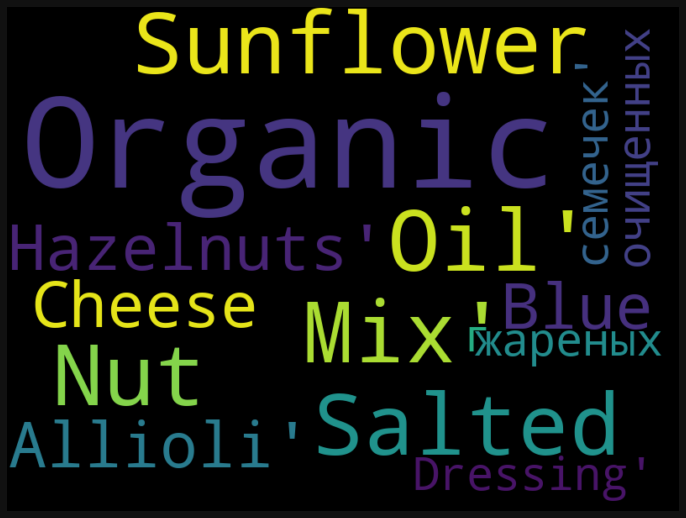

In [5]:
high_fat_food = new_data_cleaned[new_data_cleaned.fat_100g > new_data_cleaned.fat_100g.quantile(.97)]
high_fat_text = high_fat_food['product_name'].values

wordcloud = WordCloud(
    width = 800,
    height = 600,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_fat_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
    
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

high_carbohydrate_food

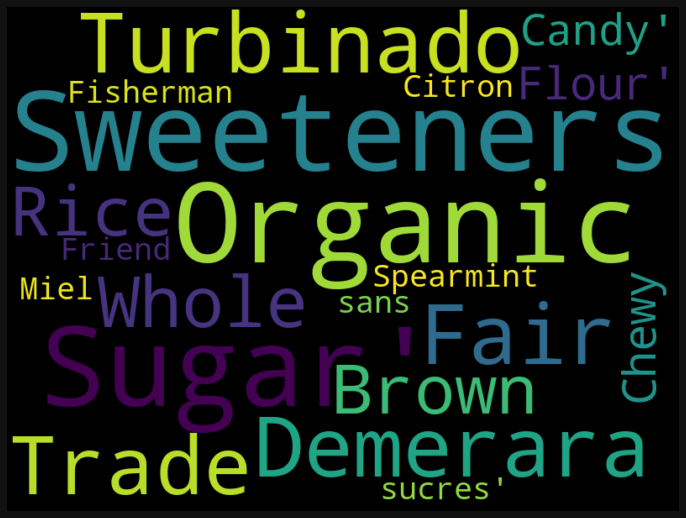

In [6]:
high_carbohydrate_food = new_data_cleaned[new_data_cleaned.carbohydrates_100g > new_data_cleaned.carbohydrates_100g.quantile(.97)]
high_carbohydrate_text = high_carbohydrate_food['product_name'].values

wordcloud = WordCloud(
    width = 800,
    height = 600,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_carbohydrate_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
    
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

High Sugar Food

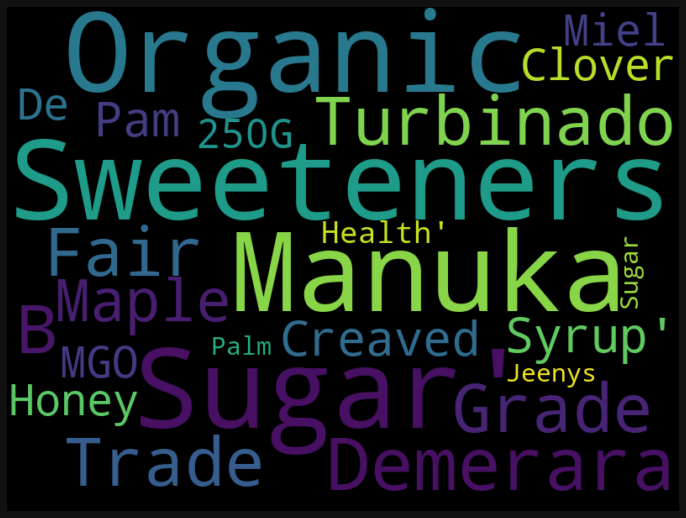

In [7]:
high_sugar_food = new_data_cleaned[new_data_cleaned.sugars_100g > new_data_cleaned.sugars_100g.quantile(.97)]
high_sugar_text = high_sugar_food['product_name'].values

wordcloud = WordCloud(
    width = 800,
    height = 600,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_sugar_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
    
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

High Protein Food

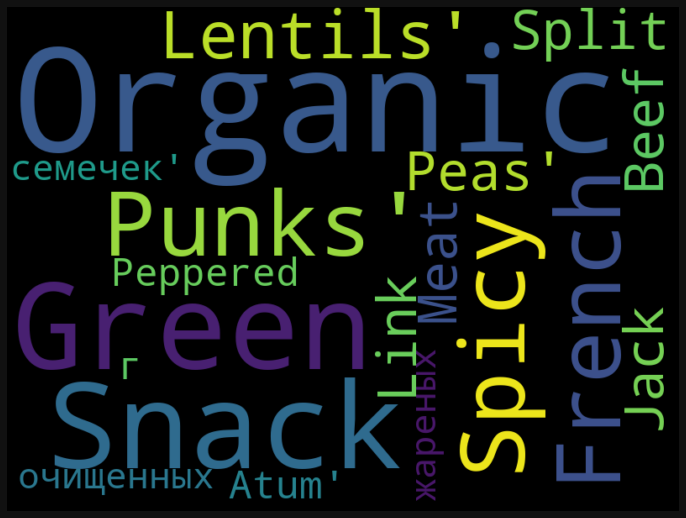

In [8]:
high_protein_food = new_data_cleaned[new_data_cleaned.proteins_100g > new_data_cleaned.proteins_100g.quantile(.97)]
high_protein_text = high_protein_food['product_name'].values

wordcloud = WordCloud(
    width = 800,
    height = 600,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_protein_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
    
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

High Salt Food

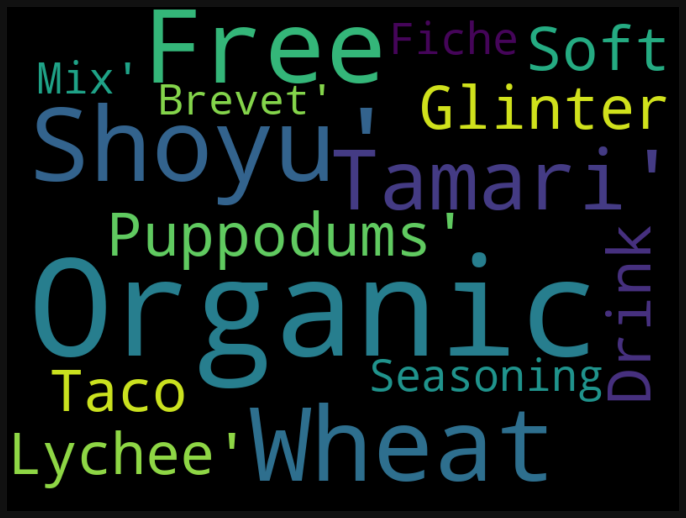

In [9]:
high_salt_food = new_data_cleaned[new_data_cleaned.salt_100g > new_data_cleaned.salt_100g.quantile(.97)]
high_salt_text = high_salt_food['product_name'].values

wordcloud = WordCloud(
    width = 800,
    height = 600,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_salt_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

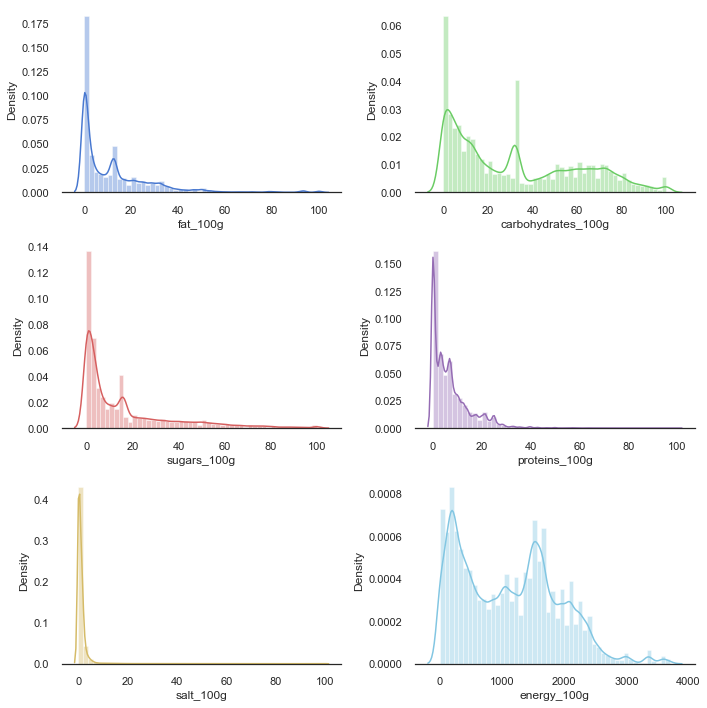

In [10]:
# Distribution plot # 
warnings.filterwarnings("ignore")
sns.set(style='white', palette='muted', color_codes=True)

f, axes = plt.subplots(3, 2, figsize=(10, 10))
sns.despine(left=True)

sns.distplot(new_data_cleaned['fat_100g'], color='b', ax=axes[0, 0])
sns.distplot(new_data_cleaned['carbohydrates_100g'], color='g', ax=axes[0, 1])
sns.distplot(new_data_cleaned['sugars_100g'], color='r', ax=axes[1, 0])
sns.distplot(new_data_cleaned['proteins_100g'], color='m', ax=axes[1, 1])
sns.distplot(new_data_cleaned['salt_100g'], color='y', ax=axes[2, 0])
sns.distplot(new_data_cleaned['energy_100g'], color='c', ax=axes[2, 1])

plt.tight_layout()

<AxesSubplot:>

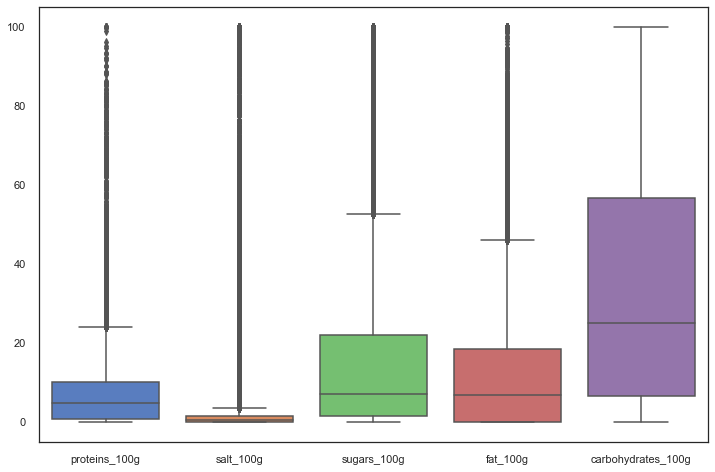

In [11]:
# boxplots
plt.figure(figsize=(12,8))
boxplot_data = new_data_cleaned[['proteins_100g','salt_100g','sugars_100g','fat_100g','carbohydrates_100g']]
sns.boxplot(data = boxplot_data)

<AxesSubplot:xlabel='nutrition_grade_fr', ylabel='Count'>

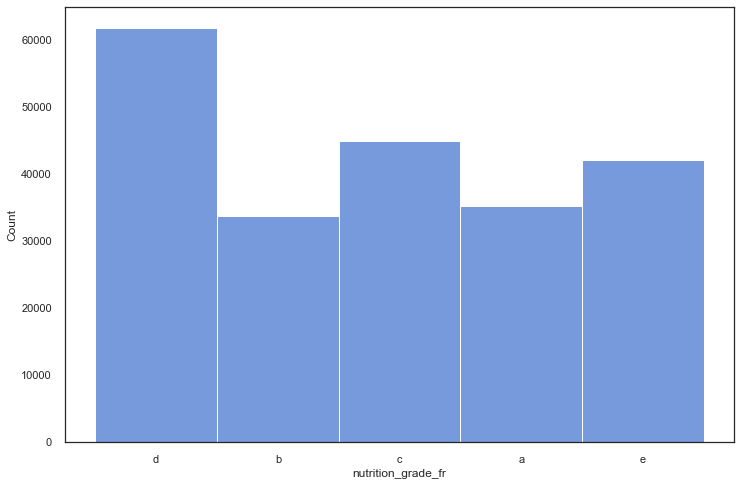

In [12]:
#histogramm pour nutrition grade (pour les lignes qui n'ont pas de valeur manquante)#
histogram_data = new_data_cleaned['nutrition_grade_fr']
new_data_cleaned['nutrition_grade_fr'] = pd.Categorical(new_data_cleaned['nutrition_grade_fr'],
                                   categories=['a', 'b', 'c', 'd', 'e'],
                                   ordered=True)
plt.figure(figsize=(12, 8))
sns.histplot(data = histogram_data)

### Apprentissage non-supervisé (K-Means, PCA)

PCA pour la réduction de dimension

In [13]:
# normalisation
new_data_cleaned_cluster = new_data_cleaned[['energy_100g' ,'proteins_100g','salt_100g','sugars_100g','fat_100g','carbohydrates_100g']]
scaler = StandardScaler()
data_cluster_FT = scaler.fit_transform(new_data_cleaned_cluster)


In [14]:
# Covariance matrix computation pour connaître les corrélartions (the correlations between all the possible pairs of variables)
cov_matrix = np.cov(data_cluster_FT.T)
cov_matrix

array([[ 1.0000039 ,  0.2948687 , -0.08231346,  0.31188373,  0.74984255,
         0.49491989],
       [ 0.2948687 ,  1.0000039 , -0.00280266, -0.25398539,  0.23629295,
        -0.08917378],
       [-0.08231346, -0.00280266,  1.0000039 , -0.05979667, -0.04946859,
        -0.07548355],
       [ 0.31188373, -0.25398539, -0.05979667,  1.0000039 , -0.03969836,
         0.62436991],
       [ 0.74984255,  0.23629295, -0.04946859, -0.03969836,  1.0000039 ,
        -0.0844917 ],
       [ 0.49491989, -0.08917378, -0.07548355,  0.62436991, -0.0844917 ,
         1.0000039 ]])

In [15]:
# 
eig_vals, eig_vecs = np.linalg.eig(cov_matrix)

print('Eigenvectors \n%s' %eig_vecs)
print('\nEigenvalues \n%s' %eig_vals)
total = sum(eig_vals)
var_exp = [(i / total)*100 for i in sorted(eig_vals, reverse=True)]
cum_var_exp = np.cumsum(var_exp)

trace1 = dict(
    type='bar',
    x=['PC %s' %i for i in range(1,7)],
    y=var_exp,
    name='Individual'
)

trace2 = dict(
    type='scatter',
    x=['PC %s' %i for i in range(1,7)], 
    y=cum_var_exp,
    name='Cumulative'
)
data = [trace1, trace2]

layout=dict(
    title='Explained variance by different principal components',
    yaxis=dict(
        title='Explained variance in percent'
    ),
    annotations=list([
        dict(
            x=1.16,
            y=1.05,
            xref='paper',
            yref='paper',
            text='Explained Variance',
            showarrow=False,
        )
    ])
)

fig = dict(data=data, layout=layout)
iplot(fig)

# The plot above clearly shows that most of the variance (83.95% of the variance to be precise) can be explained by the first three principal components. 
# The forth principal component still bears some information (10.59%) while the fifth and sixth principal components can safely be dropped without losing to much information. 
# Together, the first four principal components contain 94.53% of the information.

Eigenvectors 
[[-0.63967133 -0.22520732  0.70222084 -0.19205215 -0.07266524  0.06945413]
 [-0.12464172 -0.51036159 -0.12027711  0.28151131  0.79359784  0.02197159]
 [ 0.11927131 -0.02574181 -0.00279544 -0.0100877  -0.02213798  0.9922258 ]
 [-0.40750178  0.505138   -0.0100911   0.75744114 -0.01128771  0.06950956]
 [-0.40929331 -0.50064178 -0.56181871  0.09641867 -0.50626955  0.02431287]
 [-0.47694934  0.42701695 -0.42032059 -0.54840856  0.32862724  0.06898283]]

Eigenvalues 
[2.12029955 1.68776913 0.04918663 0.3702098  0.78902725 0.98353101]


In [16]:
# PCA
pca = PCA(n_components=4)
principal_components = pca.fit_transform(data_cluster_FT)
principal_components

array([[ 1.79820778,  0.13146023, -0.06999898, -0.55476022],
       [ 1.50517926,  0.58703097,  0.03183923,  1.14915499],
       [ 1.94037891,  2.95190507,  0.08363048, -0.60264748],
       ...,
       [-2.11125061, -0.24562615, -0.51503978, -0.51971091],
       [-2.15884366, -0.26924433, -0.52554886, -0.56592859],
       [-0.46035511,  0.32873786, -0.34113064, -0.75887311]])

In [17]:
# meaning of principal componentes
F1 = pca.components_[0]
F2 = pca.components_[1]
F3 = pca.components_[2]
F4 = pca.components_[3]
print(F1)
print(F2)
print(F3)
print(F4)

[ 0.63967133  0.12464172 -0.11927131  0.40750178  0.40929331  0.47694934]
[ 0.22520732  0.51036159  0.02574181 -0.505138    0.50064178 -0.42701695]
[0.06945413 0.02197159 0.9922258  0.06950956 0.02431287 0.06898283]
[-0.07266524  0.79359784 -0.02213798 -0.01128771 -0.50626955  0.32862724]


In [18]:
pca_table = pd.DataFrame((np.array(F1), np.array(F2), np.array(F3), np.array(F4)),
                        columns=['energy_100g', 'proteins_100g','salt_100g','sugars_100g','fat_100g','carbohydrates_100g'])
new_col = ['F1','F2','F3','F4']
pca_table.insert(0,'Principal_components', value=new_col)
pca_table['meaning'] = ['High energy foods, ',
                        'Low-carb diets, diabetes friendly, Ketogenic diet',
                        'Hypertension unfriendly',
                        'High proteins foods for muscle building']
pca_table

,Principal_components,energy_100g,proteins_100g,salt_100g,sugars_100g,fat_100g,carbohydrates_100g,meaning
0,F1,0.639671,0.124642,-0.119271,0.407502,0.409293,0.476949,"High energy foods,"
1,F2,0.225207,0.510362,0.025742,-0.505138,0.500642,-0.427017,"Low-carb diets, diabetes friendly, Ketogenic diet"
2,F3,0.069454,0.021972,0.992226,0.069510,0.024313,0.068983,Hypertension unfriendly
3,F4,-0.072665,0.793598,-0.022138,-0.011288,-0.506270,0.328627,High proteins foods for muscle building


In [19]:
pc_df = pd.DataFrame(data=principal_components, columns=['High energy foods', 'Low-carb diets, diabetes friendly', 'Hypertension unfriendly', 'High proteins foods for muscle building'])
pc_df.head(3)

,High energy foods,"Low-carb diets, diabetes friendly",Hypertension unfriendly,High proteins foods for muscle building
0,1.798208,0.131460,-0.069999,-0.554760
1,1.505179,0.587031,0.031839,1.149155
2,1.940379,2.951905,0.083630,-0.602647


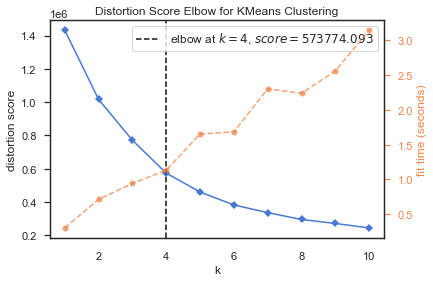

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [20]:
#Elbow Method pour déterminer n
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(pc_df)
visualizer.poof() 

In [21]:

k_means = KMeans(n_clusters=4)
kmeans = k_means.fit(pc_df)
pc_df['cluster'] = [str(i) for i in list(kmeans.labels_)]
pc_df['product'] = list(new_data_cleaned['product_name'].values)
pc_df['text'] = pc_df['cluster'] + '_' + pc_df['product']
pc_df.head()

,High energy foods,"Low-carb diets, diabetes friendly",Hypertension unfriendly,High proteins foods for muscle building,cluster,product,text
0,1.798208,0.131460,-0.069999,-0.554760,0,Banana Chips Sweetened (Whole),0_Banana Chips Sweetened (Whole)
1,1.505179,0.587031,0.031839,1.149155,0,Peanuts,0_Peanuts
2,1.940379,2.951905,0.083630,-0.602647,1,Organic Salted Nut Mix,1_Organic Salted Nut Mix
3,0.863341,-0.803208,0.136329,0.970613,0,Organic Polenta,0_Organic Polenta
4,1.343815,0.439043,0.159259,0.740142,0,Breadshop Honey Gone Nuts Granola,0_Breadshop Honey Gone Nuts Granola


High energy foods

Low-carb diets, diabetes friendly

Hypertension unfriendly

3D-plot pour les gens qui souhaitent avoir la bonne santé

In [28]:
trace = go.Scatter3d(
    x=pc_df['High energy foods'],
    y=pc_df['Low-carb diets, diabetes friendly'],
    z=pc_df['Hypertension unfriendly'],
    text= pc_df['text'],
    mode='markers',
    marker=dict(
        size=12,
        color=[int(i) for i in list(pc_df['cluster'].values)],              
        colorscale='Viridis',   
        opacity=0.8
    )
)

data = [trace]
layout = go.Layout(
    showlegend=False,
    title='Different Kinds of Food',
    scene = dict(
        xaxis = dict(title='X: High energy foods'),
        yaxis = dict(title='Y: Low-carb diets, diabetes friendly'),
        zaxis = dict(title='Z: Hypertension unfriendly'),
    ),
    width=1000,
    height=800,
)
fig = go.Figure(data=data, layout=layout)

iplot(fig)

High energy foods

Low-carb diets, diabetes friendly

High proteins foods for muscle building

3D_plot pour les gens qui souhaitent contrôler leurs poids (faire du sport ou faire du régime)

In [24]:
# trace = go.Scatter3d(
#     x=pc_df['High energy foods'],
#     y=pc_df['Low-carb diets, diabetes friendly'],
#     z=pc_df['High proteins foods for muscle building'],
#     text= pc_df['text'],
#     mode='markers',
#     marker=dict(
#         size=12,
#         color=[int(i) for i in list(pc_df['cluster'].values)],              
#         colorscale='Viridis',   
#         opacity=0.8
#     )
# )

# data = [trace]
# layout = go.Layout(
#     showlegend=False,
#     title='Different Kinds of Food',
#     scene = dict(
#         xaxis = dict(title='X: High energy foods'),
#         yaxis = dict(title='Y: Low-carb diets, diabetes friendly'),
#         zaxis = dict(title='Z: High proteins foods for muscle building'),
#     ),
#     width=800,
#     height=600,
# )
# fig = go.Figure(data=data, layout=layout)
# iplot(fig)